In [1]:
import cv2
import gdown
import os
import random
import shutil
import zipfile

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

random.seed(123)

# Descarga del DataSet

In [2]:
# Se descargan datos originales de entrenamiento y validación de Visdrone

# !gdown --id 1a2oHjcEcwXP8oUF95qiwrqzACb2YlUhn
!gdown --id 1AyXDdDptyxTwksetR5NnKvnI4mY9FqGJ
with zipfile.ZipFile("VisDrone2019-DET-train.zip", 'r') as zip_ref:
    zip_ref.extractall("/content")
os.remove("VisDrone2019-DET-train.zip")

# !gdown --id 1bxK5zgLn0_L8x276eKkuYA_FzwCIjb59
!gdown --id 1GSK33lrOLmhH9YGxbu8EQ6aVnHLE8Bw_
with zipfile.ZipFile("VisDrone2019-DET-val.zip", 'r') as zip_ref:
    zip_ref.extractall("/content")
os.remove("VisDrone2019-DET-val.zip")

/usr/local/lib/python3.10/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1AyXDdDptyxTwksetR5NnKvnI4mY9FqGJ
From (redirected): https://drive.google.com/uc?id=1AyXDdDptyxTwksetR5NnKvnI4mY9FqGJ&confirm=t&uuid=45023900-cbc9-4b0f-88b3-27e329d0e46e
To: /content/VisDrone2019-DET-train.zip
100% 1.55G/1.55G [00:27<00:00, 56.3MB/s]
/usr/local/lib/python3.10/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1GSK33lrOLmhH9YGxbu8EQ6aVnHLE8Bw_
From (redirected): https://drive.google.com/uc?id=1GSK33lrOLmhH9YGxbu8EQ6aVnHLE8Bw_&confirm=t&uuid=d19ea31f-f3b3-4dc6-87ff-36ffd4c6feec
To: /conten

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Conversion de las anotaciones a formato YOLO

In [4]:
def visdrone2yolo(dir):
    from PIL import Image
    from tqdm import tqdm

    def convert_box(size, box):
        # Convert VisDrone box to YOLO xywh box
        dw = 1. / size[0]
        dh = 1. / size[1]
        return (box[0] + box[2] / 2) * dw, (box[1] + box[3] / 2) * dh, box[2] * dw, box[3] * dh

    (dir / 'labels').mkdir(parents=True, exist_ok=True)  # make labels directory
    pbar = tqdm((dir / 'annotations').glob('*.txt'), desc=f'Converting {dir}')
    for f in pbar:
        img_size = Image.open((dir / 'images' / f.name).with_suffix('.jpg')).size
        lines = []
        with open(f, 'r') as file:  # read annotation.txt
            for row in [x.split(',') for x in file.read().strip().splitlines()]:
                if row[4] == '0':  # VisDrone 'ignored regions' class 0
                    continue
                cls = int(row[5]) - 1
                box = convert_box(img_size, tuple(map(int, row[:4])))
                lines.append(f"{cls} {' '.join(f'{x:.6f}' for x in box)}\n")
                with open(str(f).replace(os.sep + 'annotations' + os.sep, os.sep + 'labels' + os.sep), 'w') as fl:
                    fl.writelines(lines)  # write label.txt

In [5]:
from pathlib import Path

train_dir = Path('/content/VisDrone2019-DET-train')
val_dir = Path('/content/VisDrone2019-DET-val')

visdrone2yolo(train_dir)
visdrone2yolo(val_dir)

Converting /content/VisDrone2019-DET-train: 6471it [00:38, 167.50it/s]
Converting /content/VisDrone2019-DET-val: 548it [00:03, 137.40it/s]


In [6]:
%%writefile label_map.txt
0 pedestrian
1 people
2 bicycle
3 car
4 van
5 truck
6 tricycle
7 awning-tricycle
8 bus
9 motor

Writing label_map.txt


In [7]:
# Directorio de imágenes y etiquetas
images_dir_train = 'VisDrone2019-DET-train/images'
labels_dir_train = 'VisDrone2019-DET-train/labels'

images_dir_val = 'VisDrone2019-DET-val/images'
labels_dir_val = 'VisDrone2019-DET-val/labels'

# Analisis de Datos

## Codigo de las Clases

In [8]:
file_path = 'label_map.txt'

# Leer el archivo y crear una lista de diccionarios con label y category
data = []
with open(file_path, 'r') as file:
    for line in file:
        label, category = line.strip().split(' ', 1)
        data.append({'label': int(label), 'category': category})

# Convertir la lista de diccionarios en un DataFrame
df = pd.DataFrame(data)
df

,label,category
0,0,pedestrian
1,1,people
2,2,bicycle
3,3,car
4,4,van
5,5,truck
6,6,tricycle
7,7,awning-tricycle
8,8,bus
9,9,motor


In [9]:
def show_images_with_bboxes(image_files, images_dir, labels_dir, df):
  """
  Muestra imágenes con sus correspondientes bounding boxes.

  Args:
    image_files: Lista de nombres de archivos de imágenes.
    images_dir: Directorio donde se encuentran las imágenes.
    labels_dir: Directorio donde se encuentran las etiquetas.
    df: DataFrame con la información de las etiquetas (label y category).
  """
  for image_file in image_files:
      image_path = os.path.join(images_dir, image_file)
      label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))

      # Cargar la imagen
      image = cv2.imread(image_path)
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

      # Cargar las etiquetas
      if os.path.exists(label_path):
          with open(label_path, 'r') as f:
              for line in f:
                  class_id, x_center, y_center, width, height, *_ = line.strip().split()
                  class_id = int(class_id)
                  x_center = float(x_center)
                  y_center = float(y_center)
                  width = float(width)
                  height = float(height)

                  # Calcular las coordenadas de la bounding box
                  image_height, image_width, _ = image.shape
                  x_min = int((x_center - width / 2) * image_width)
                  y_min = int((y_center - height / 2) * image_height)
                  x_max = int((x_center + width / 2) * image_width)
                  y_max = int((y_center + height / 2) * image_height)

                  # Dibujar la bounding box
                  cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)

                  # Obtener la etiqueta de la categoría
                  category = df[df['label'] == class_id]['category'].values[0]

                  # Agregar la etiqueta a la bounding box
                  cv2.putText(image, category, (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

      # Mostrar la imagen
      plt.figure(figsize=(10, 6))
      plt.imshow(image)
      plt.title(image_file)
      plt.axis('off')
      plt.show()

# Nuevo DataSet

In [10]:
def filter_bboxes_by_area(image_file, images_dir, labels_dir, area_threshold=0.001):
    """
    Filtra las bounding boxes en una imagen basándose en un umbral de área.

    Args:
      image_file: El nombre del archivo de imagen (e.g., 'imagen.jpg').
      images_dir: El directorio donde se encuentra la imagen.
      labels_dir: El directorio donde se encuentra el archivo de etiquetas.
      area_threshold: El umbral de área mínima para las bounding boxes.

    Returns:
      Una lista de líneas (labels) que cumplen con el criterio de área.
    """
    image_path = os.path.join(images_dir, image_file)
    label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))

    filtered_lines = []
    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            for line in f:
                class_id, x_center, y_center, width, height, *_ = line.strip().split()
                area = float(width) * float(height)
                if area >= area_threshold:
                    filtered_lines.append(line)
    return filtered_lines

# Ejemplo de uso
image_file = '9999937_00000_d_0000219.jpg'
images_dir = 'VisDrone2019-DET-train/images'
labels_dir = 'VisDrone2019-DET-train/labels'
area_threshold = 0.001  # Puedes ajustar este valor

filtered_labels = filter_bboxes_by_area(image_file, images_dir, labels_dir, area_threshold)

print(f"Labels filtrados para {image_file}:")
for line in filtered_labels:
    print(line.strip())

Labels filtrados para 9999937_00000_d_0000219.jpg:
3 0.909447 0.647032 0.047495 0.051020
3 0.892484 0.620130 0.041754 0.043599
3 0.871086 0.590445 0.049061 0.045455
4 0.832724 0.501391 0.058977 0.043599
3 0.853862 0.528293 0.043841 0.023191
5 0.482516 0.720315 0.046451 0.268089
7 0.406054 0.803803 0.019833 0.069573
7 0.325157 0.860390 0.018789 0.060297
5 0.404749 0.544527 0.021399 0.053803


In [11]:
def filter_bboxes_by_class_and_area(image_file, images_dir, labels_dir, df, excluded_classes, area_threshold=0.001):
    """
    Filtra las bounding boxes en una imagen basándose en la clase a la que pertenecen y al area del bounding box.

    Args:
      image_file: El nombre del archivo de imagen (e.g., 'imagen.jpg').
      images_dir: El directorio donde se encuentra la imagen.
      labels_dir: El directorio donde se encuentra el archivo de etiquetas.
      df: DataFrame que contiene las categorías de las clases.
      excluded_classes: Lista con los nombres de las clases a excluir.
      area_threshold: El umbral de área mínima para las bounding boxes.

    Returns:
      Una lista de líneas (labels) que cumplen con el criterio de clase.
    """
    image_path = os.path.join(images_dir, image_file)
    label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))
    filtered_lines = []
    excluded_indexes = []
    new_indexed_lines = []
    new_label_list = []
    new_index = 0

    # Obtenemos los indices correspondientes a las categoria a excluir
    for category in excluded_classes:
        index = df[df['category'] == category].index[0]
        excluded_indexes.append(str(index))

    # Calculamos un nuevo DataFrame con la columna "new_label" con los nuevos indices de las clases no excluidas
    for cat in df["category"]:
        if cat not in excluded_classes:
            new_label_list.append(new_index)
            new_index += 1
        else:
            new_label_list.append("X")

    df_edited = df.copy()
    df_edited["new_label"] = new_label_list

    # Modificamos la data dentro del annotation
    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            for line in f:
                # class_id, *_ = line.strip().split()
                class_id, x_center, y_center, width, height, *_ = line.strip().split()
                area = float(width) * float(height)
                if class_id not in excluded_indexes and area >= area_threshold:
                    filtered_lines.append(line)

            for f_line in filtered_lines:
                class_id, x_center, y_center, width, height = f_line.strip().split()
                new_class_id = df_edited.loc[df_edited["label"] == int(class_id), "new_label"].iloc[0]
                new_line = " ".join([str(new_class_id), x_center, y_center, width, height])
                new_indexed_lines.append(new_line)

    return new_indexed_lines

# Ejemplo de uso
image_file = '9999937_00000_d_0000219.jpg'
images_dir = 'VisDrone2019-DET-train/images'
labels_dir = 'VisDrone2019-DET-train/labels'
excluded_classes = ["people", "bicycle", "tricycle", "awning-tricycle"]  # Puedes ajustar estas clases

filtered_labels = filter_bboxes_by_class_and_area(image_file, images_dir, labels_dir, df, excluded_classes)

print(f"Clases filtradas para {image_file}:")
for line in filtered_labels:
    print(line.strip())

Clases filtradas para 9999937_00000_d_0000219.jpg:
1 0.909447 0.647032 0.047495 0.051020
1 0.892484 0.620130 0.041754 0.043599
1 0.871086 0.590445 0.049061 0.045455
2 0.832724 0.501391 0.058977 0.043599
1 0.853862 0.528293 0.043841 0.023191
3 0.482516 0.720315 0.046451 0.268089
3 0.404749 0.544527 0.021399 0.053803


In [12]:
%%writefile new_label_map.txt
0 pedestrian
1 car
2 van
3 truck
4 bus
5 motor

Writing new_label_map.txt


In [13]:
file_path = 'new_label_map.txt'

# Leer el archivo y crear una lista de diccionarios con label y category
data = []
with open(file_path, 'r') as file:
    for line in file:
        label, category = line.strip().split(' ', 1)
        data.append({'label': int(label), 'category': category})

# Convertir la lista de diccionarios en un DataFrame
df_new = pd.DataFrame(data)
df_new

,label,category
0,0,pedestrian
1,1,car
2,2,van
3,3,truck
4,4,bus
5,5,motor


En base a los filtrados anteriores se va a armar un dataset nuevo conteniendo unicamente las imagenes con mayor área en los bounding boxes y excluyendo las clases: "people", "bicycle", "tricycle" y "awning-tricycle"

In [14]:
import os
import shutil
import random
from shutil import copyfile

In [15]:
def filter_and_save_labels(images_dir, labels_dir, output_dir, df, excluded_classes, area_threshold=0.001, num_images=50):
    """
    Selecciona imágenes aleatorias, filtra las bounding boxes por área y guarda las imágenes y
    labels filtrados en un nuevo directorio.

    Args:
      images_dir: Directorio de imágenes.
      labels_dir: Directorio de etiquetas.
      output_dir: Directorio de salida.
      area_threshold: Umbral de área para filtrar bounding boxes.
      num_images: Número de imágenes a seleccionar.
    """
    # Crea el directorio de salida si no existe
    os.makedirs(output_dir, exist_ok=True)
    os.makedirs(os.path.join(output_dir, 'images'), exist_ok=True)
    os.makedirs(os.path.join(output_dir, 'labels'), exist_ok=True)

    # Selecciona imágenes aleatorias
    image_files = random.sample(os.listdir(images_dir), num_images)

    for image_file in image_files:
        # Copia la imagen al directorio de salida
        image_path = os.path.join(images_dir, image_file)
        output_image_path = os.path.join(output_dir, 'images', image_file)
        copyfile(image_path, output_image_path)

        # Filtra las bounding boxes
        label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))
        filtered_labels = filter_bboxes_by_class_and_area(image_file, images_dir, labels_dir, df, excluded_classes, area_threshold)

        # Guarda las etiquetas filtradas
        if len(filtered_labels) > 0: # no se guardan los .txt sin labels
            output_label_path = os.path.join(output_dir, 'labels', image_file.replace('.jpg', '.txt'))
            with open(output_label_path, 'w') as f:
                for line in filtered_labels:
                    f.write(line + '\n')

In [16]:
# Ejemplo de uso
images_dir = 'VisDrone2019-DET-train/images'
labels_dir = 'VisDrone2019-DET-train/labels'
output_dir = 'VisDrone-ClassAreaFilter-train'
excluded_classes = ["people", "bicycle", "tricycle", "awning-tricycle"]
area_threshold = 0.001
num_images = 500

filter_and_save_labels(images_dir, labels_dir, output_dir, df, excluded_classes, area_threshold, num_images)

In [17]:
def delete_images_without_labels(images_dir, labels_dir):
  """
  Elimina las imágenes que no tienen un archivo de etiquetas correspondiente.

  Args:
    images_dir: Directorio de imágenes.
    labels_dir: Directorio de etiquetas.
  """
  for image_file in os.listdir(images_dir):
    if image_file.endswith('.jpg'):
      label_file = image_file.replace('.jpg', '.txt')
      label_path = os.path.join(labels_dir, label_file)
      if not os.path.exists(label_path):
        image_path = os.path.join(images_dir, image_file)
        os.remove(image_path)
        print(f"Imagen eliminada: {image_file}")

In [18]:
# Ejemplo de uso
delete_images_without_labels(images_dir, labels_dir)

# Visualización de las Clases

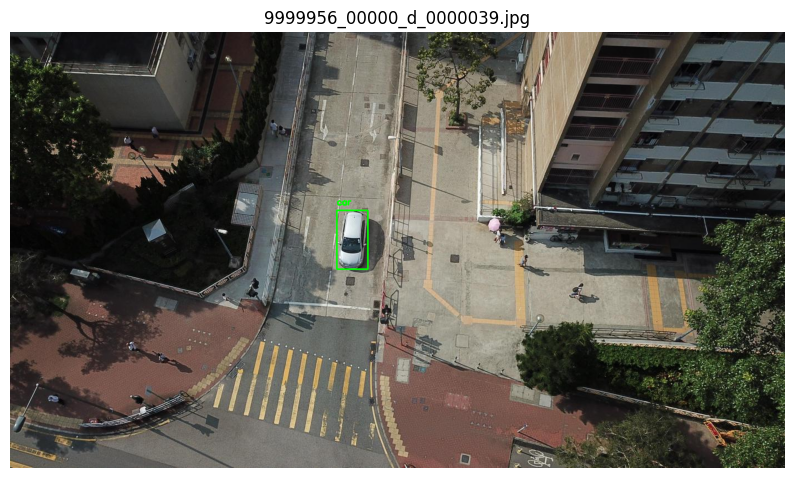

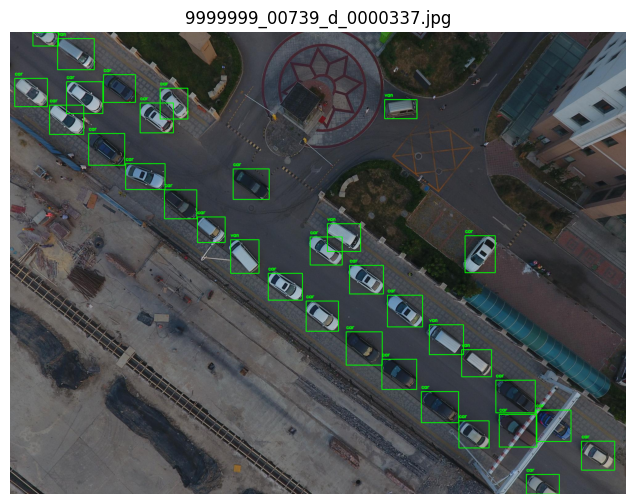

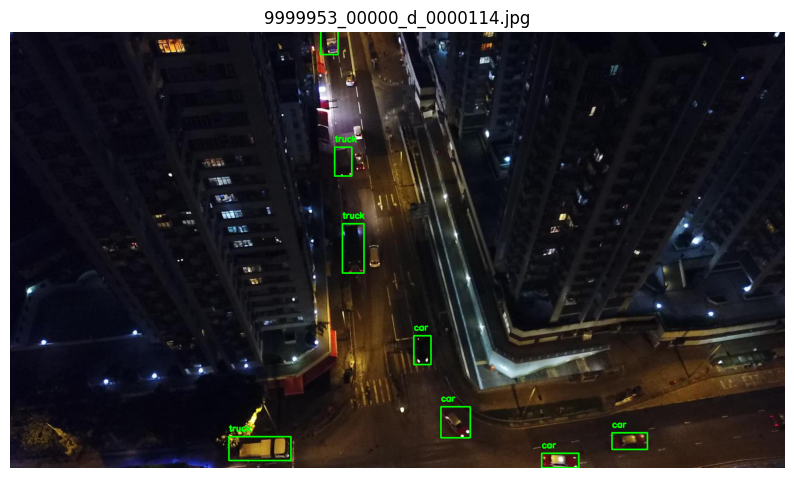

In [19]:
# Número de ejemplos a mostrar
num_examples = 3

# Lista de archivos de imágenes
image_files = [f for f in os.listdir(f'{output_dir}/images') if f.endswith('.jpg')]

# Seleccionar ejemplos aleatorios
random_image_files = random.sample(image_files, num_examples)

show_images_with_bboxes(random_image_files, f'{output_dir}/images', f'{output_dir}/labels', df_new)

Repetimos el proceso de filtrado con el dataset de validación

In [20]:
# Repetimos el proceso para el dataset de validacion

images_dir = 'VisDrone2019-DET-val/images'
labels_dir = 'VisDrone2019-DET-val/labels'
output_dir = 'VisDrone-ClassAreaFilter-val'
excluded_classes = ["people", "bicycle", "tricycle", "awning-tricycle"]
area_threshold = 0.001
num_images = 500

filter_and_save_labels(images_dir, labels_dir, output_dir, df, excluded_classes, area_threshold, num_images)

In [21]:
delete_images_without_labels(images_dir, labels_dir)

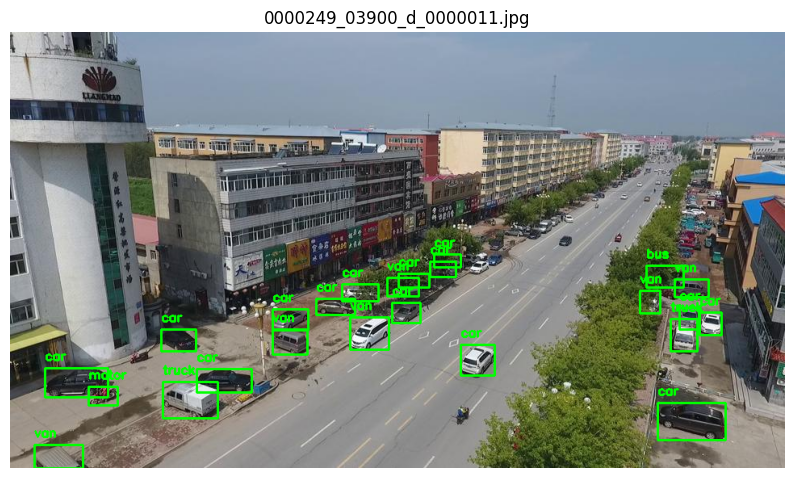

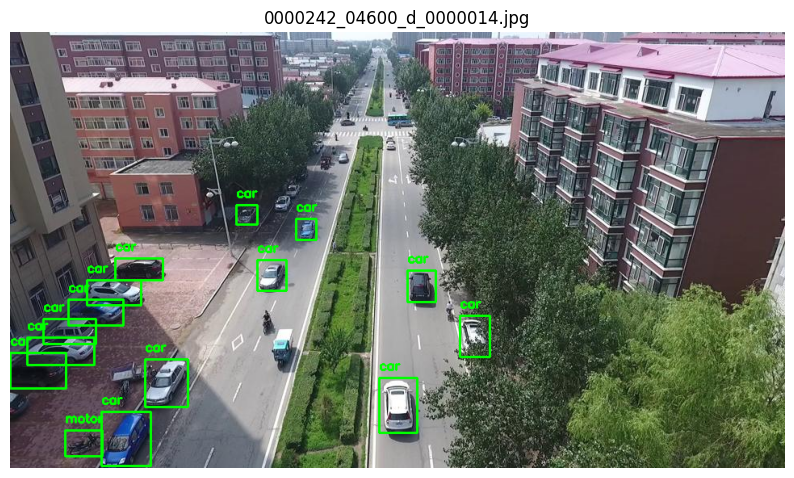

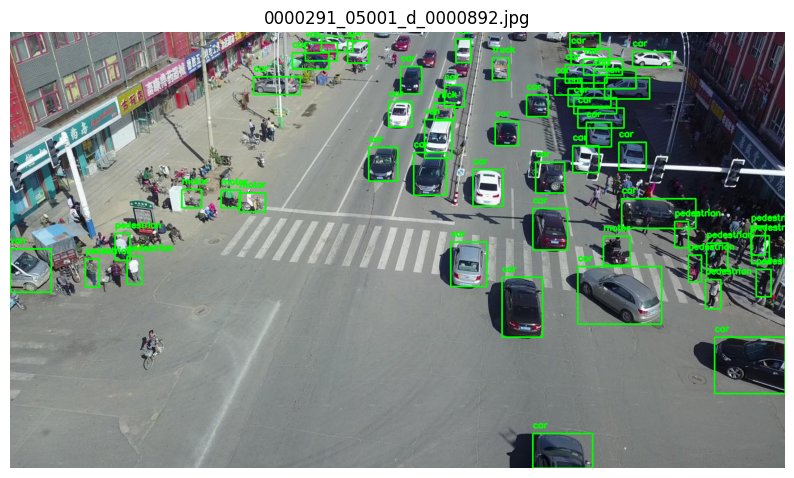

In [22]:
# Número de ejemplos a mostrar
num_examples = 3

# Lista de archivos de imágenes
image_files = [f for f in os.listdir(f'{output_dir}/images') if f.endswith('.jpg')]

# Seleccionar ejemplos aleatorios
random_image_files = random.sample(image_files, num_examples)

show_images_with_bboxes(random_image_files, f'{output_dir}/images', f'{output_dir}/labels', df_new)

# Nuevo Balance de Clases

Cantidad de imagenes: 475


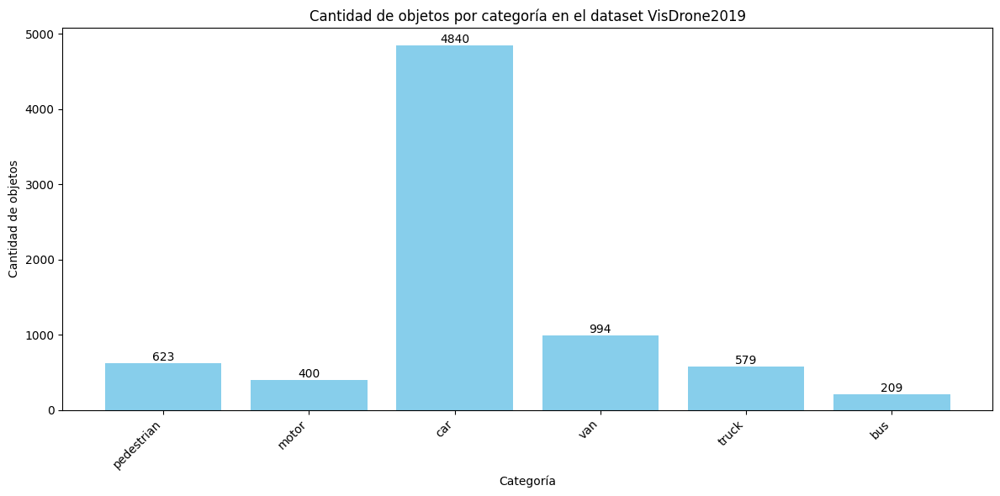

In [23]:
category_counts = {}
images = 0
labels_dir_train = 'VisDrone-ClassAreaFilter-train/labels' #'VisDrone2019-DET-train/labels'

# Iterar sobre todos los archivos .txt en la carpeta
for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        # Abrir el archivo y contar cuántos objetos hay por categoría
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            images += 1
            for line in file:
                category = int(line.split()[0])  # El label de la categoría es la primera columna en YOLO
                category_counts[category] = category_counts.get(category, 0) + 1

# Convertir los datos a un DataFrame para facilitar el manejo
df_counts = pd.DataFrame(list(category_counts.items()), columns=['label', 'count'])
print("Cantidad de imagenes:",images)

df_merged = pd.merge(df_counts, df_new, on='label')

plt.figure(figsize=(12, 6))
bars = plt.bar(df_merged['category'], df_merged['count'], color='skyblue')
plt.xlabel('Categoría')
plt.ylabel('Cantidad de objetos')
plt.title('Cantidad de objetos por categoría en el dataset VisDrone2019')
plt.xticks(rotation=45, ha='right')

for bar in bars:
  yval = bar.get_height()
  plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), va='bottom', ha='center')

plt.tight_layout()
plt.show()

# Entrenamiento del Modelo

In [24]:
%%writefile data.yaml
train: ../../VisDrone-ClassAreaFilter-train/images
val: ../../VisDrone-ClassAreaFilter-val/images

nc: 6
names: ["pedestrian", "car", "van", "truck", "bus", "motor"]

Writing data.yaml


In [25]:
# Se carga Tensorboard para el entrenamiento

%load_ext tensorboard
%tensorboard --logdir runs/detect/train

<IPython.core.display.Javascript object>

In [26]:
!pip install ultralytics
from ultralytics import YOLO

# Cargar el modelo YOLOv8
model = YOLO('yolov8s.pt')

# Entrenar el modelo congelando las primeras 10 capas (hasta el bloque SPPF)
results = model.train(
    data='data.yaml',
    imgsz=1080,
    batch=16,
    epochs=50,
    freeze=16,  # Congela las primeras 16 capas (backbone completo)
    auto_augment=False, # Desactivar auto augmentation
    mosaic=0,          # Desactivar mosaic
    hsv_h=0,           # No variación en matiz
    hsv_s=0,           # No variación en saturación
    hsv_v=0,           # No variación en brillo
    degrees=0,         # Sin rotación
    translate=0,       # Sin traslación
    scale=0,           # Sin escalado
    shear=0,           # Sin corte
    flipud=0,          # No flip vertical
    fliplr=0,          # No flip horizontal
    copy_paste=0       # Desactivar Copy-Paste
)

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 870.5/870.5 kB 23.1 MB/s eta 0:00:00
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 21.5M/21.5M [00:00<00:00, 230MB/s]


Ultralytics 8.3.13 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=1080, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=16, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_width=

100%|██████████| 755k/755k [00:00<00:00, 18.5MB/s]


Overriding model.yaml nc=80 with nc=6

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 92.5MB/s]


AMP: checks passed ✅
WARNING ⚠️ imgsz=[1080] must be multiple of max stride 32, updating to [1088]


train: Scanning /content/VisDrone-ClassAreaFilter-train/labels... 475 images, 25 backgrounds, 0 corrupt: 100%|██████████| 500/500 [00:00<00:00, 1958.00it/s]

train: New cache created: /content/VisDrone-ClassAreaFilter-train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:13: UserWarning: A new version of Albumentations is available: 1.4.18 (you have 1.4.15). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/VisDrone-ClassAreaFilter-val/labels... 497 images, 3 backgrounds, 0 corrupt: 100%|██████████| 500/500 [00:00<00:00, 842.88it/s]


val: New cache created: /content/VisDrone-ClassAreaFilter-val/labels.cache
Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001, momentum=0.9) with parameter groups 63 weight(decay=0.0), 70 weight(decay=0.0005), 69 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 1088 train, 1088 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      5.37G      1.273      3.835      1.132         59       1088: 100%|██████████| 32/32 [00:18<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:09<00:00,  1.74it/s]


                   all        500      10241     0.0535      0.357      0.109     0.0687

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50         5G      1.288      2.645      1.082         53       1088: 100%|██████████| 32/32 [00:13<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:10<00:00,  1.53it/s]


                   all        500      10241     0.0409      0.532      0.147     0.0831

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      4.91G      1.208      2.208      1.035         33       1088: 100%|██████████| 32/32 [00:12<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:11<00:00,  1.45it/s]

                   all        500      10241     0.0581      0.667      0.218      0.135



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      5.13G      1.141      1.978      1.005        103       1088: 100%|██████████| 32/32 [00:14<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:08<00:00,  1.93it/s]

                   all        500      10241      0.418      0.278      0.255      0.155



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      5.32G      1.076      1.787     0.9788        101       1088: 100%|██████████| 32/32 [00:14<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:10<00:00,  1.46it/s]


                   all        500      10241      0.384      0.313      0.304      0.187

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      5.13G      1.014      1.624     0.9535         53       1088: 100%|██████████| 32/32 [00:12<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:10<00:00,  1.46it/s]

                   all        500      10241      0.397       0.37      0.334      0.206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      4.74G     0.9454      1.538     0.9265         10       1088: 100%|██████████| 32/32 [00:14<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:08<00:00,  1.92it/s]

                   all        500      10241      0.369      0.403      0.338      0.211



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      4.97G     0.8833      1.362     0.9104         79       1088: 100%|██████████| 32/32 [00:14<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:09<00:00,  1.64it/s]


                   all        500      10241      0.412      0.406       0.35      0.218

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      5.15G     0.8483      1.273     0.8974         34       1088: 100%|██████████| 32/32 [00:13<00:00,  2.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:10<00:00,  1.53it/s]

                   all        500      10241      0.385      0.391      0.334      0.203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      4.99G     0.8171      1.212     0.8863         66       1088: 100%|██████████| 32/32 [00:15<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:08<00:00,  1.98it/s]

                   all        500      10241      0.391      0.396       0.34      0.211



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      5.55G     0.7607       1.14     0.8717         11       1088: 100%|██████████| 32/32 [00:15<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:08<00:00,  1.78it/s]


                   all        500      10241      0.391      0.419      0.353      0.216

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      5.14G     0.7241      1.012     0.8655        104       1088: 100%|██████████| 32/32 [00:13<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:11<00:00,  1.43it/s]

                   all        500      10241      0.421       0.39      0.354      0.219



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      4.88G     0.6897     0.9472     0.8534         41       1088: 100%|██████████| 32/32 [00:13<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:08<00:00,  1.86it/s]

                   all        500      10241       0.42      0.393      0.359      0.223



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      5.14G     0.6497     0.8711     0.8431         70       1088: 100%|██████████| 32/32 [00:15<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.04it/s]


                   all        500      10241      0.402      0.404      0.358      0.223

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      5.32G     0.6138     0.8329     0.8367         46       1088: 100%|██████████| 32/32 [00:14<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:10<00:00,  1.58it/s]


                   all        500      10241      0.415      0.388      0.358      0.221

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      5.01G     0.6108     0.8192     0.8355        100       1088: 100%|██████████| 32/32 [00:13<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:10<00:00,  1.57it/s]

                   all        500      10241        0.4      0.407      0.354      0.219



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      5.18G     0.5817     0.7629     0.8286         64       1088: 100%|██████████| 32/32 [00:14<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.08it/s]

                   all        500      10241      0.441      0.379      0.362      0.225



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      5.18G     0.5576     0.7304     0.8241         69       1088: 100%|██████████| 32/32 [00:14<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:09<00:00,  1.76it/s]


                   all        500      10241      0.417      0.396      0.365      0.229

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      4.94G     0.5262     0.6908     0.8185         55       1088: 100%|██████████| 32/32 [00:13<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:10<00:00,  1.48it/s]

                   all        500      10241      0.403      0.407      0.365      0.228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      5.26G     0.5182      0.675     0.8162         92       1088: 100%|██████████| 32/32 [00:14<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:08<00:00,  1.94it/s]

                   all        500      10241      0.427       0.38      0.358      0.222



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      4.96G     0.5102     0.6591     0.8166         66       1088: 100%|██████████| 32/32 [00:15<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:08<00:00,  1.99it/s]


                   all        500      10241      0.433      0.388      0.371       0.23

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      5.02G     0.4932     0.6437     0.8128        104       1088: 100%|██████████| 32/32 [00:14<00:00,  2.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:10<00:00,  1.47it/s]

                   all        500      10241      0.444      0.386      0.368      0.228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      5.13G     0.4904      0.633      0.812         54       1088: 100%|██████████| 32/32 [00:13<00:00,  2.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:09<00:00,  1.70it/s]

                   all        500      10241       0.43      0.403      0.366      0.227



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      5.16G     0.4677     0.6049     0.8072         52       1088: 100%|██████████| 32/32 [00:14<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.09it/s]

                   all        500      10241      0.426      0.397      0.362      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      5.17G     0.4406     0.5714     0.8031         26       1088: 100%|██████████| 32/32 [00:14<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:09<00:00,  1.68it/s]


                   all        500      10241      0.429      0.392      0.361      0.225

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      4.91G     0.4324     0.5685     0.8044         50       1088: 100%|██████████| 32/32 [00:13<00:00,  2.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:10<00:00,  1.48it/s]


                   all        500      10241      0.432      0.398      0.364      0.227

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      5.11G     0.4383     0.5851     0.8043         53       1088: 100%|██████████| 32/32 [00:14<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.06it/s]

                   all        500      10241      0.434      0.399      0.365      0.227



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      4.89G     0.4186     0.5475     0.7993         37       1088: 100%|██████████| 32/32 [00:15<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:08<00:00,  1.86it/s]


                   all        500      10241      0.429        0.4      0.366      0.227

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      4.42G     0.4111     0.5302     0.7979         48       1088: 100%|██████████| 32/32 [00:13<00:00,  2.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:11<00:00,  1.43it/s]

                   all        500      10241      0.426      0.389      0.357       0.22



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      5.44G     0.4099     0.5271        0.8         41       1088: 100%|██████████| 32/32 [00:13<00:00,  2.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:08<00:00,  1.79it/s]

                   all        500      10241      0.423      0.395      0.364      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      4.96G     0.3914     0.5109     0.7945         59       1088: 100%|██████████| 32/32 [00:15<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.01it/s]


                   all        500      10241      0.426      0.408      0.363      0.225

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      4.84G     0.3828     0.4998     0.7931         48       1088: 100%|██████████| 32/32 [00:14<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:10<00:00,  1.50it/s]

                   all        500      10241      0.423      0.407      0.362      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      5.02G     0.3856     0.4941     0.7956         96       1088: 100%|██████████| 32/32 [00:13<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:10<00:00,  1.57it/s]

                   all        500      10241      0.445      0.396      0.362      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      5.14G     0.3633      0.478     0.7921         84       1088: 100%|██████████| 32/32 [00:14<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.10it/s]

                   all        500      10241      0.424      0.397      0.362      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      5.01G     0.3581     0.4663     0.7921         36       1088: 100%|██████████| 32/32 [00:15<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:09<00:00,  1.72it/s]


                   all        500      10241      0.429      0.404      0.364      0.226

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      5.02G     0.3568     0.4687     0.7901        142       1088: 100%|██████████| 32/32 [00:13<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:10<00:00,  1.52it/s]

                   all        500      10241      0.448      0.386       0.36      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      5.04G      0.355     0.4652      0.792         66       1088: 100%|██████████| 32/32 [00:14<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:08<00:00,  1.88it/s]

                   all        500      10241      0.456      0.389      0.364      0.227



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      4.99G      0.348     0.4587     0.7897         68       1088: 100%|██████████| 32/32 [00:14<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:08<00:00,  1.82it/s]


                   all        500      10241      0.436      0.388      0.361      0.225

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      5.14G      0.338     0.4576     0.7894         55       1088: 100%|██████████| 32/32 [00:13<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:11<00:00,  1.44it/s]

                   all        500      10241      0.415      0.404      0.361      0.225



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      4.44G     0.3253     0.4336     0.7889         35       1088: 100%|██████████| 32/32 [00:14<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:08<00:00,  1.82it/s]

                   all        500      10241       0.44      0.401      0.366      0.229


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      5.45G     0.3147     0.4212     0.7858        107       1088: 100%|██████████| 32/32 [00:18<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:08<00:00,  1.78it/s]


                   all        500      10241      0.466      0.383      0.364      0.227

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      5.02G     0.3137      0.417     0.7862         45       1088: 100%|██████████| 32/32 [00:13<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:10<00:00,  1.46it/s]

                   all        500      10241      0.453      0.386      0.365      0.228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50       5.3G     0.3163     0.4274     0.7877         88       1088: 100%|██████████| 32/32 [00:13<00:00,  2.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:09<00:00,  1.70it/s]

                   all        500      10241      0.454      0.383      0.364      0.227



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      5.28G     0.3146     0.4211     0.7882         93       1088: 100%|██████████| 32/32 [00:15<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.10it/s]

                   all        500      10241      0.436      0.394      0.364      0.227



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      5.38G     0.2973     0.4023     0.7848         72       1088: 100%|██████████| 32/32 [00:15<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:09<00:00,  1.70it/s]


                   all        500      10241      0.454      0.389      0.366      0.229

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      5.07G     0.3021     0.4113     0.7845         70       1088: 100%|██████████| 32/32 [00:13<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:10<00:00,  1.47it/s]

                   all        500      10241      0.445      0.394      0.364      0.227



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      4.75G     0.2919      0.402     0.7841         76       1088: 100%|██████████| 32/32 [00:15<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:07<00:00,  2.10it/s]

                   all        500      10241      0.444      0.389      0.363      0.227



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      5.04G     0.2973     0.4029     0.7857         54       1088: 100%|██████████| 32/32 [00:15<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:08<00:00,  1.90it/s]


                   all        500      10241      0.439      0.392      0.363      0.227

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      5.14G      0.293     0.4029     0.7869         45       1088: 100%|██████████| 32/32 [00:14<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:11<00:00,  1.35it/s]

                   all        500      10241      0.441      0.389      0.363      0.228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      5.17G     0.2783     0.3892     0.7837         42       1088: 100%|██████████| 32/32 [00:13<00:00,  2.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:09<00:00,  1.61it/s]

                   all        500      10241      0.442      0.393      0.363      0.227



50 epochs completed in 0.349 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 20.0MB
Optimizer stripped from runs/detect/train/weights/best.pt, 20.0MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.13 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 186 layers, 9,829,986 parameters, 0 gradients, 23.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:17<00:00,  1.10s/it]


                   all        500      10241       0.44      0.383      0.371       0.23
            pedestrian        251       1157      0.526      0.497      0.516      0.273
                   car        457       6640      0.708      0.763      0.778      0.552
                   van        336        938      0.245      0.325      0.218       0.15
                 truck        200        440      0.278      0.143      0.118     0.0643
                   bus         83        134      0.477      0.351      0.356      0.246
                 motor        304        932      0.403      0.221      0.239     0.0968
Speed: 0.5ms preprocess, 8.1ms inference, 0.0ms loss, 4.6ms postprocess per image
Results saved to runs/detect/train


In [27]:
def predict_and_show_images_comparison(image_files, model, images_dir, labels_dir, df, confidence_threshold=0.5):
  """
  Realiza predicciones con el modelo YOLO en un conjunto de imágenes y muestra las imágenes con las bounding boxes, comparando
  la predicción con las etiquetas reales.

  Args:
    image_files: Una lista de nombres de archivos de imágenes.
    model: El modelo YOLO a utilizar para las predicciones.
    images_dir: El directorio donde se encuentran las imágenes.
    labels_dir: Directorio donde se encuentran las etiquetas.
    df: DataFrame con la información de las etiquetas (label y category).
    confidence_threshold: El umbral de confianza para las predicciones.
  """
  for image_file in image_files:
      image_path = os.path.join(images_dir, image_file)
      label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))

      # Realizar la predicción
      results = model(image_path)

      # Obtener la primera predicción (si hay más de una)
      predicted_image = cv2.imread(image_path)
      predicted_image = cv2.cvtColor(predicted_image, cv2.COLOR_BGR2RGB)
      if results and results[0].boxes:
          boxes = results[0].boxes.xywh.cpu().numpy()  # Coordenadas de las bounding boxes
          confidence = results[0].boxes.conf.cpu().numpy()
          class_ids = results[0].boxes.cls.cpu().numpy().astype(int)

          for box, conf, cls_id in zip(boxes, confidence, class_ids):
              if conf >= confidence_threshold:
                  x_center, y_center, width, height = box
                  x_min = int(x_center - width / 2)
                  y_min = int(y_center - height / 2)
                  x_max = int(x_center + width / 2)
                  y_max = int(y_center + height / 2)

                  # Dibujar la bounding box
                  cv2.rectangle(predicted_image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)

                  # Obtener la etiqueta de la categoría
                  category = df[df['label'] == cls_id]['category'].values[0]

                  # Agregar la etiqueta a la bounding box
                  cv2.putText(predicted_image, f"{category}: {conf:.2f}", (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)


      # Cargar la imagen real con las bounding boxes reales
      real_image = cv2.imread(image_path)
      real_image = cv2.cvtColor(real_image, cv2.COLOR_BGR2RGB)

      # Cargar las etiquetas
      if os.path.exists(label_path):
          with open(label_path, 'r') as f:
              for line in f:
                  class_id, x_center, y_center, width, height, *_ = line.strip().split()
                  class_id = int(class_id)
                  x_center = float(x_center)
                  y_center = float(y_center)
                  width = float(width)
                  height = float(height)

                  # Calcular las coordenadas de la bounding box
                  image_height, image_width, _ = real_image.shape
                  x_min = int((x_center - width / 2) * image_width)
                  y_min = int((y_center - height / 2) * image_height)
                  x_max = int((x_center + width / 2) * image_width)
                  y_max = int((y_center + height / 2) * image_height)

                  # Dibujar la bounding box
                  cv2.rectangle(real_image, (x_min, y_min), (x_max, y_max), (0, 0, 255), 2)

                  # Obtener la etiqueta de la categoría
                  category = df[df['label'] == class_id]['category'].values[0]

                  # Agregar la etiqueta a la bounding box
                  cv2.putText(real_image, category, (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)


      # Combinar las imágenes lado a lado
      combined_image = np.concatenate((predicted_image, real_image), axis=1)

      # Mostrar la imagen combinada
      plt.figure(figsize=(15, 6))
      plt.imshow(combined_image)
      plt.title(f"Predicción vs. Real - {image_file}")
      plt.axis('off')
      plt.show()

In [28]:
# Directorio de imágenes y etiquetas
images_dir_train = 'VisDrone-ClassAreaFilter-train/images'
labels_dir_train = 'VisDrone-ClassAreaFilter-train/labels'

images_dir_val = 'VisDrone-ClassAreaFilter-val/images'
labels_dir_val = 'VisDrone-ClassAreaFilter-val/labels'


image 1/1 /content/VisDrone-ClassAreaFilter-val/images/0000330_00601_d_0000803.jpg: 640x1088 16 cars, 2 vans, 1 truck, 39.5ms
Speed: 5.3ms preprocess, 39.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 1088)


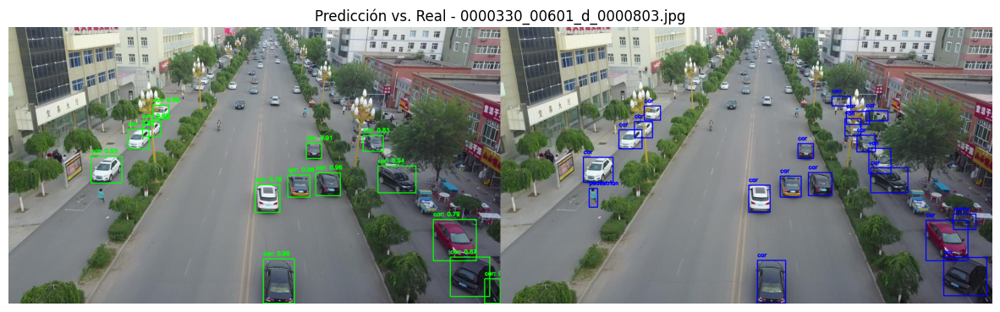


image 1/1 /content/VisDrone-ClassAreaFilter-val/images/0000289_02401_d_0000823.jpg: 640x1088 16 cars, 2 vans, 25.4ms
Speed: 13.6ms preprocess, 25.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 1088)


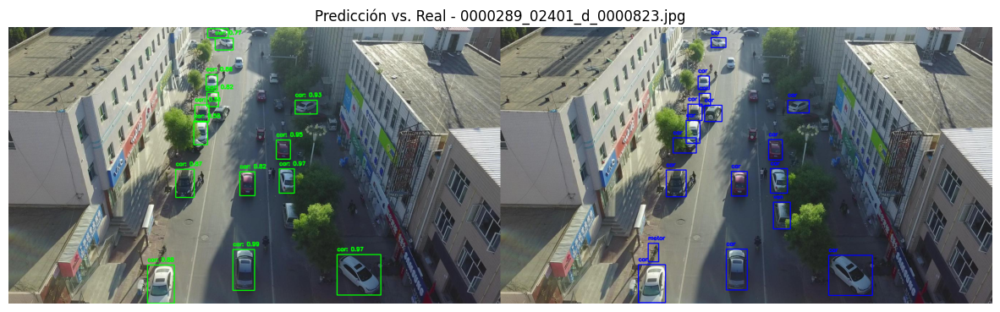


image 1/1 /content/VisDrone-ClassAreaFilter-val/images/0000327_03001_d_0000726.jpg: 640x1088 15 cars, 3 vans, 1 bus, 1 motor, 25.9ms
Speed: 15.1ms preprocess, 25.9ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 1088)


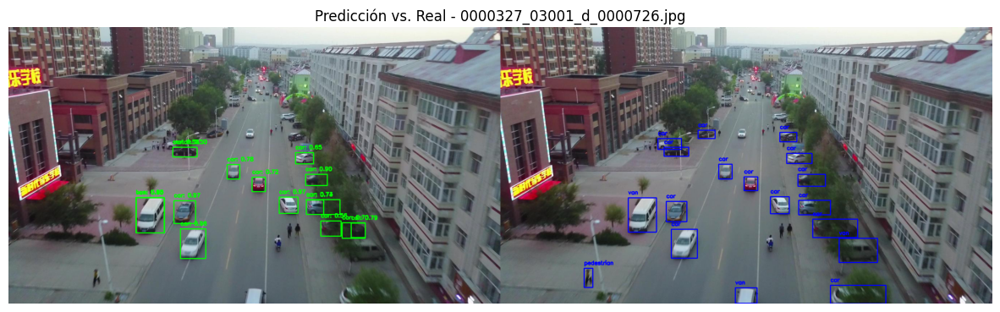


image 1/1 /content/VisDrone-ClassAreaFilter-val/images/0000086_00000_d_0000001.jpg: 640x1088 25 pedestrians, 32.1ms
Speed: 15.1ms preprocess, 32.1ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 1088)


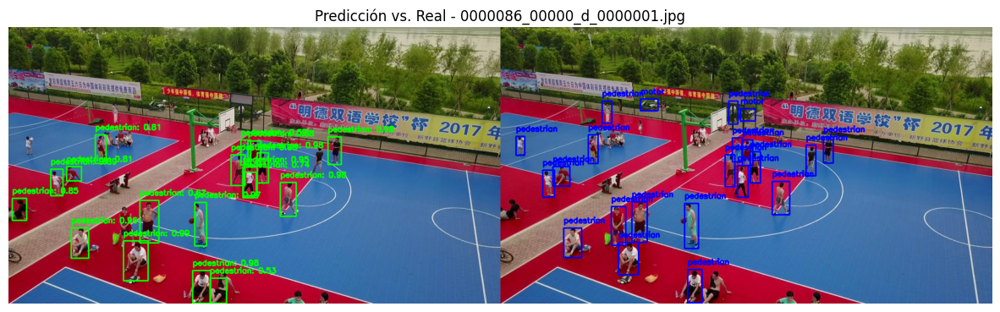


image 1/1 /content/VisDrone-ClassAreaFilter-val/images/0000291_01601_d_0000876.jpg: 640x1088 8 pedestrians, 15 cars, 3 vans, 2 motors, 52.9ms
Speed: 22.6ms preprocess, 52.9ms inference, 9.9ms postprocess per image at shape (1, 3, 640, 1088)


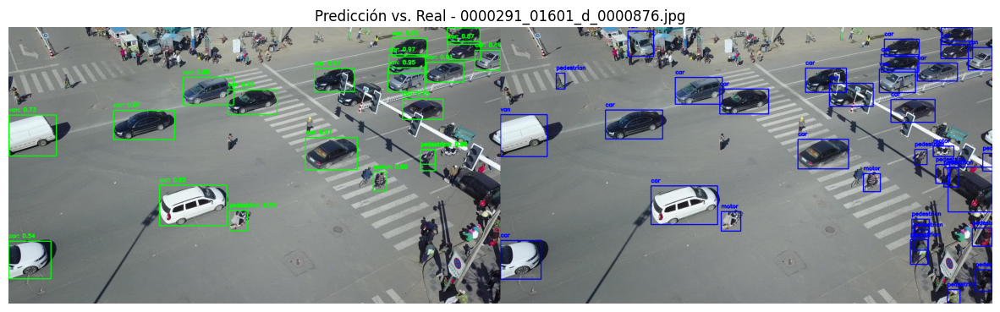


image 1/1 /content/VisDrone-ClassAreaFilter-val/images/0000289_03201_d_0000827.jpg: 640x1088 1 pedestrian, 19 cars, 2 vans, 31.6ms
Speed: 15.6ms preprocess, 31.6ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 1088)


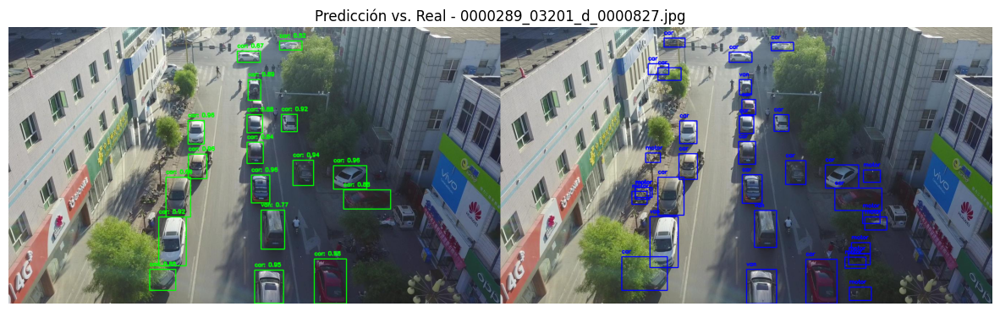


image 1/1 /content/VisDrone-ClassAreaFilter-val/images/0000022_00000_d_0000004.jpg: 640x1088 7 pedestrians, 1 van, 26.5ms
Speed: 11.3ms preprocess, 26.5ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 1088)


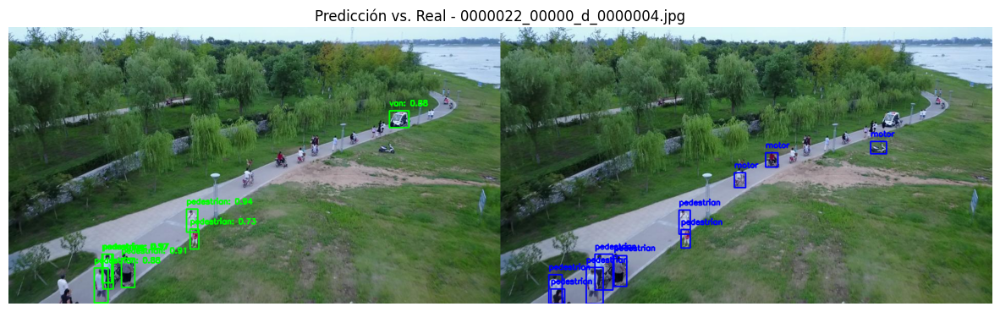


image 1/1 /content/VisDrone-ClassAreaFilter-val/images/0000103_03349_d_0000031.jpg: 640x1088 1 pedestrian, 1 car, 1 bus, 39.2ms
Speed: 6.4ms preprocess, 39.2ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 1088)


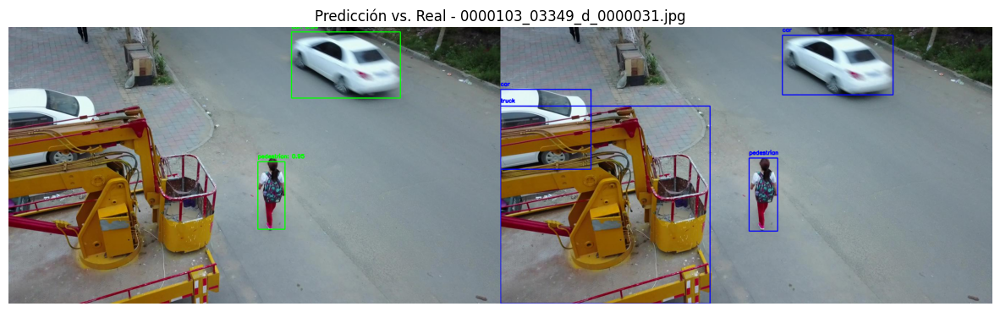


image 1/1 /content/VisDrone-ClassAreaFilter-val/images/0000316_01601_d_0000527.jpg: 640x1088 7 cars, 1 van, 24.0ms
Speed: 15.7ms preprocess, 24.0ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 1088)


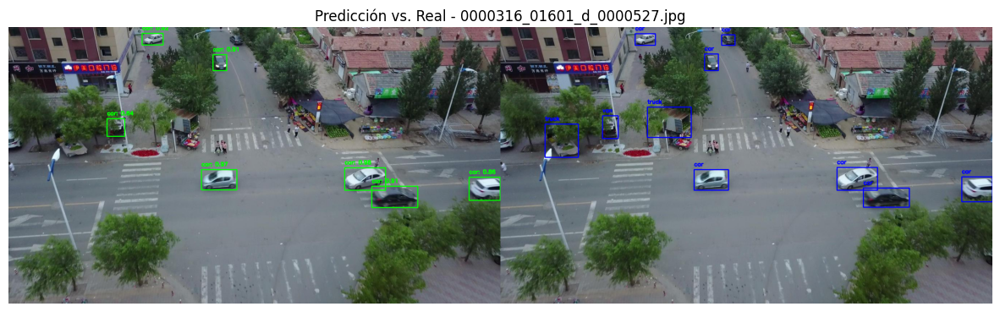


image 1/1 /content/VisDrone-ClassAreaFilter-val/images/0000335_00393_d_0000045.jpg: 640x1088 8 cars, 2 vans, 1 motor, 38.4ms
Speed: 25.1ms preprocess, 38.4ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 1088)


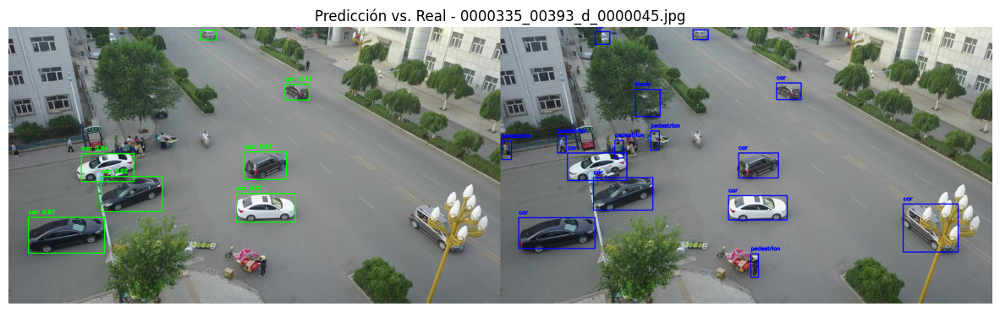

In [29]:
# Ejemplos en validación
image_files_to_predict = random.sample(os.listdir(images_dir_val), 10)

# Realizar predicciones y mostrar las imágenes con las bounding boxes
predict_and_show_images_comparison(image_files_to_predict, model, images_dir_val, labels_dir_val, df_new)

In [30]:
from google.colab import files

# Save the model to a file (e.g., 'best.pt')
model.save('model.pt')

# Download the saved model to your local machine
files.download('model.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## RetinaNet

In [31]:
# Se eliminan imágenes del set de entrenamiento que no tienen anotaciones
images_dir = 'VisDrone-ClassAreaFilter-train/images'
labels_dir = 'VisDrone-ClassAreaFilter-train/labels'
delete_images_without_labels(images_dir, labels_dir)

Imagen eliminada: 9999998_00026_d_0000019.jpg
Imagen eliminada: 9999977_00000_d_0000077.jpg
Imagen eliminada: 9999997_00000_d_0000028.jpg
Imagen eliminada: 9999982_00000_d_0000160.jpg
Imagen eliminada: 9999987_00000_d_0000010.jpg
Imagen eliminada: 9999937_00000_d_0000120.jpg
Imagen eliminada: 9999984_00000_d_0000020.jpg
Imagen eliminada: 9999997_00000_d_0000045.jpg
Imagen eliminada: 9999981_00000_d_0000009.jpg
Imagen eliminada: 9999984_00000_d_0000127.jpg
Imagen eliminada: 9999975_00000_d_0000017.jpg
Imagen eliminada: 0000210_01551_d_0000228.jpg
Imagen eliminada: 9999977_00000_d_0000054.jpg
Imagen eliminada: 9999975_00000_d_0000020.jpg
Imagen eliminada: 9999982_00000_d_0000183.jpg
Imagen eliminada: 9999955_00000_d_0000135.jpg
Imagen eliminada: 0000180_01400_d_0000026.jpg
Imagen eliminada: 9999955_00000_d_0000187.jpg
Imagen eliminada: 0000180_00000_d_0000019.jpg
Imagen eliminada: 9999997_00000_d_0000052.jpg
Imagen eliminada: 0000263_05001_d_0000192.jpg
Imagen eliminada: 9999997_00000_d_

In [32]:
# Se eliminan imágenes del set de validación que no tienen anotaciones
images_dir = 'VisDrone-ClassAreaFilter-val/images'
labels_dir = 'VisDrone-ClassAreaFilter-val/labels'
delete_images_without_labels(images_dir, labels_dir)

Imagen eliminada: 0000276_02001_d_0000517.jpg
Imagen eliminada: 0000276_05801_d_0000536.jpg
Imagen eliminada: 0000276_05601_d_0000535.jpg


In [33]:
import json
from PIL import Image

def yolo_to_coco(categories, image_folder, label_folder, output_file):
    """
    Convierte archivos de formato YOLO a COCO format

    Args:
        categories (list): Lista de diccionarios que definen las categorías en COCO.
        image_folder (str): Ruta de la carpeta que contiene las imágenes.
        label_folder (str): Ruta de la carpeta que contiene las etiquetas en formato YOLO.
        output_file (str): Ruta del archivo de salida en formato COCO.
    """

    # Se crea diccionario para almacenar la información en formato COCO
    coco = {
        "images": [],
        "annotations": [],
        "categories": []
    }

    coco['categories'] = categories

    annotation_id = 1

    for image_file in os.listdir(image_folder):
        if not image_file.endswith('.jpg'):
            continue

        image_path = os.path.join(image_folder, image_file)
        image = Image.open(image_path)
        width, height = image.size

        image_info = {
            "id": len(coco['images']) + 1,
            "file_name": image_file,
            "width": width,
            "height": height
        }
        coco['images'].append(image_info)

        label_file = os.path.join(label_folder, image_file.replace('.jpg', '.txt'))

        with open(label_file) as f:
            lines = f.readlines()
            for line in lines:
                parts = line.strip().split()
                class_id = int(parts[0])
                x_center = float(parts[1]) * width
                y_center = float(parts[2]) * height
                bbox_width = float(parts[3]) * width
                bbox_height = float(parts[4]) * height

                x_min = x_center - bbox_width / 2
                y_min = y_center - bbox_height / 2

                annotation = {
                    "id": annotation_id,
                    "image_id": image_info['id'],
                    "category_id": class_id + 1,  # Asignar ID a partir de 1
                    "bbox": [x_min, y_min, bbox_width, bbox_height],
                    "area": bbox_width * bbox_height,
                    "iscrowd": 0
                }
                coco['annotations'].append(annotation)
                annotation_id += 1

    with open(output_file, 'w') as f:
        json.dump(coco, f, indent=4)

In [34]:
# Categorías actuales
categories = [
        {'id': 1, 'name': 'pedestrian'},
        {'id': 2, 'name': 'car'},
        {'id': 3, 'name': 'van'},
        {'id': 4, 'name': 'truck'},
        {'id': 5, 'name': 'bus'},
        {'id': 6, 'name': 'motor'},
    ]

# Se convierten las anotaciones en los sets de entrenamiento y validación

yolo_to_coco(categories, 'VisDrone-ClassAreaFilter-train/images', 'VisDrone-ClassAreaFilter-train/labels', 'VisDrone-ClassAreaFilter-train/coco_annotations.json')
yolo_to_coco(categories, 'VisDrone-ClassAreaFilter-val/images', 'VisDrone-ClassAreaFilter-val/labels', 'VisDrone-ClassAreaFilter-val/coco_annotations.json')

In [35]:
import sys, os, distutils.core, locale

# Set locale to UTF-8
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding

!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

Cloning into 'detectron2'...
remote: Enumerating objects: 15792, done.
remote: Counting objects: 100% (49/49), done.
remote: Compressing objects: 100% (39/39), done.
remote: Total 15792 (delta 15), reused 31 (delta 10), pack-reused 15743 (from 1)
Receiving objects: 100% (15792/15792), 6.36 MiB | 11.37 MiB/s, done.
Resolving deltas: 100% (11511/11511), done.
Ignoring dataclasses: markers 'python_version < "3.7"' don't match your environment
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 4.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.2/79.2 kB 6.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 6.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 8.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 16.2 MB/s eta 0:00:

In [36]:
# Se validan las versiones actuales de las tecnologías a utilizar
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2023 NVIDIA Corporation
Built on Tue_Aug_15_22:02:13_PDT_2023
Cuda compilation tools, release 12.2, V12.2.140
Build cuda_12.2.r12.2/compiler.33191640_0
torch:  2.4 ; cuda:  cu121
detectron2: 0.6


In [37]:
# Se configura detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [42]:
from detectron2.data.datasets import register_coco_instances

# Se chequea si el dataset ya está registrado
if "my_dataset_train" in DatasetCatalog:
    # Si ya está registrado se elimina
    DatasetCatalog.remove("my_dataset_train")
    MetadataCatalog.remove("my_dataset_train")
if "my_dataset_val" in DatasetCatalog:
    # Si ya está registrado se elimina
    DatasetCatalog.remove("my_dataset_val")
    MetadataCatalog.remove("my_dataset_val")

# Se registra el dataset, dividido en entrenamiento y validación
register_coco_instances("my_dataset_train", {},"/content/VisDrone-ClassAreaFilter-train/coco_annotations.json", "/content/VisDrone-ClassAreaFilter-train/images")
register_coco_instances("my_dataset_val", {}, "/content/VisDrone-ClassAreaFilter-val/coco_annotations.json", "/content/VisDrone-ClassAreaFilter-val/images")

In [43]:
# Se carga tensorboard para el próximo entrenamiento RetinaNet

%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6007 (pid 7778), started 0:05:32 ago. (Use '!kill 7778' to kill it.)

<IPython.core.display.Javascript object>

## Entrenamiento 1 RetinaNet

In [44]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()

cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/retinanet_R_50_FPN_1x.yaml"))

# Se definen los datasets a utilizar
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)

# Se utilizaron 2 workers, dado que disponemos de 2 vCPUs en Colab
cfg.DATALOADER.NUM_WORKERS = 2

# Se cargan los pesos preentrenados del modelo (RetinaNet con la arquitectura R-50 (ResNet-50) y una FPN (Feature Pyramid Network) entrenada en el dataset COCO)
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/retinanet_R_50_FPN_1x.yaml")

# Es equivalente al batch size. Se utilizó 8 dado que fue el límite soportado por Colab experimentalmente
cfg.SOLVER.IMS_PER_BATCH = 8

# Inicialmente se prueba con este learning rate, aunque tal vez sea adecuado definir un decay en iteraciones específicas
cfg.SOLVER.BASE_LR = 0.001

# Número de iteraciones (no es lo mismo que la cantidad de épocas)
cfg.SOLVER.MAX_ITER = 1000

# Número de ROIs utilizados para evaluar la pérdida
cfg.MODEL.RETINANET.BATCH_SIZE_PER_IMAGE = 128   # "RoIHead batch size"
cfg.MODEL.RETINANET.NUM_CLASSES = 10

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[10/16 08:16:30 d2.engine.defaults]: Model:
RetinaNet(
  (backbone): FPN(
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelP6P7(
      (p6): Conv2d(2048, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (p7): Conv2d(256, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    )
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res2)

model_final_bfca0b.pkl: 152MB [00:01, 117MB/s]                           
head.cls_score.{bias, weight}
  pixel_mean
  pixel_std


[10/16 08:16:32 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.10/dist-packages/torch/functional.py:513: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3609.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[10/16 08:17:25 d2.utils.events]:  eta: 0:42:21  iter: 19  total_loss: 1.886  loss_cls: 1.535  loss_box_reg: 0.4116    time: 2.6296  last_time: 2.4603  data_time: 0.4363  last_data_time: 0.2218   lr: 1.9981e-05  max_mem: 7235M
[10/16 08:18:18 d2.utils.events]:  eta: 0:40:51  iter: 39  total_loss: 1.473  loss_cls: 1.167  loss_box_reg: 0.2897    time: 2.6201  last_time: 2.7522  data_time: 0.4010  last_data_time: 0.5290   lr: 3.9961e-05  max_mem: 7235M
[10/16 08:19:10 d2.utils.events]:  eta: 0:40:00  iter: 59  total_loss: 1.238  loss_cls: 0.9822  loss_box_reg: 0.2497    time: 2.6187  last_time: 2.4471  data_time: 0.3900  last_data_time: 0.2742   lr: 5.9941e-05  max_mem: 7235M
[10/16 08:20:01 d2.utils.events]:  eta: 0:39:18  iter: 79  total_loss: 1.165  loss_cls: 0.9327  loss_box_reg: 0.2255    time: 2.6053  last_time: 2.7299  data_time: 0.3376  last_data_time: 0.3796   lr: 7.9921e-05  max_mem: 7235M
[10/16 08:20:53 d2.utils.events]:  eta: 0:38:34  iter: 99  total_loss: 1.117  loss_cls: 0.

In [45]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

# Se inicializa el predictor que utiliza la configuración del modelo previamente definida
predictor = DefaultPredictor(cfg)

# Se crea un evaluador basado en el formato COCO para medir el rendimiento del modelo en validación
evaluator = COCOEvaluator("my_dataset_val", output_dir="./output")

# Data loader que cargará las imágenes y anotaciones desde el conjunto de validación
val_loader = build_detection_test_loader(cfg, "my_dataset_val")

# Se imprimen las métricas de evaluación
print(inference_on_dataset(predictor.model, val_loader, evaluator))

[10/16 09:17:25 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-Detection/retinanet_R_50_FPN_1x/190397773/model_final_bfca0b.pkl ...


head.cls_score.{bias, weight}
  pixel_mean
  pixel_std


[10/16 09:17:25 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
[10/16 09:17:26 d2.data.datasets.coco]: Loaded 497 images in COCO format from /content/VisDrone-ClassAreaFilter-val/coco_annotations.json
[10/16 09:17:26 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[10/16 09:17:26 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[10/16 09:17:26 d2.data.common]: Serializing 497 elements to byte tensors and concatenating them all ...
[10/16 09:17:26 d2.data.common]: Serialized dataset takes 0.68 MiB
[10/16 09:17:26 d2.evaluation.evaluator]: Start inference on 497 batches
[10/16 09:17:28 d2.evaluation.evaluator]: Inference done 11/497. Dataloading: 0.0123 s/iter. Inference: 0.1132 s/iter. Eval: 0.0004 s/iter. Total: 0.1259 s/iter. ETA=0:01:01
[10/16 09:17:33 d2.evaluation.eva

AssertionError: A prediction has class=7, but the dataset only has 6 classes and predicted class id should be in [0, 5].

In [ ]:
# Compara predicciones contra reales de RetinaNet

from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
import matplotlib.pyplot as plt
import time

# Función para visualizar las predicciones y las etiquetas reales
def compare_predictions_with_ground_truth(image_files, images_dir, labels_dir, predictor, df):
    """
    Compara las predicciones con las etiquetas reales para una lista de imágenes, e imprime el tiempo de inferencia.

    Args:
      image_files: Lista de nombres de archivos de imágenes.
      images_dir: Directorio de imágenes.
      labels_dir: Directorio de etiquetas.
      predictor: Objeto predictor de Detectron2.
      df: DataFrame de las etiquetas de clases.
    """

    for image_file in image_files:
        image_path = os.path.join(images_dir, image_file)
        label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))

        im = cv2.imread(image_path)

        # Medir tiempo de inferencia
        start_time = time.time()
        outputs = predictor(im)
        inference_time = time.time() - start_time

        print(f"Tiempo de inferencia para {image_file}: {inference_time:.4f} segundos")

        # Visualizar predicciones
        v = Visualizer(im[:, :, ::-1], MetadataCatalog.get("my_dataset_train"), scale=1.2)
        out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
        prediction_image = out.get_image()[:, :, ::-1]

        # Visualizar etiquetas reales
        real_image = im.copy()
        if os.path.exists(label_path):
            with open(label_path, 'r') as f:
                for line in f:
                    class_id, x_center, y_center, width, height, *_ = line.strip().split()
                    x_center = float(x_center)
                    y_center = float(y_center)
                    width = float(width)
                    height = float(height)

                    x_min = int((x_center - width / 2) * im.shape[1])
                    y_min = int((y_center - height / 2) * im.shape[0])
                    x_max = int((x_center + width / 2) * im.shape[1])
                    y_max = int((y_center + height / 2) * im.shape[0])

                    label_name = df[df['label'] == int(class_id)]['category'].values[0] if not df[df['label'] == int(class_id)].empty else "Unknown"
                    cv2.rectangle(real_image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)
                    cv2.putText(real_image, label_name, (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

        # Mostrar las imágenes lado a lado
        plt.figure(figsize=(20, 10))
        plt.subplot(1, 2, 1)
        plt.imshow(prediction_image[:, :, ::-1])
        plt.title("Predicción")

        plt.subplot(1, 2, 2)
        plt.imshow(real_image[:, :, ::-1])
        plt.title("Etiqueta Real")

        plt.show()

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/retinanet_R_50_FPN_1x.yaml"))
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.RETINANET.NUM_CLASSES = 10
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5

predictor = DefaultPredictor(cfg)

num_images_to_compare = 20
images_dir = 'VisDrone-AreaFilter-val/images'
labels_dir = 'VisDrone-AreaFilter-val/labels'
image_files = os.listdir(images_dir)
random_image_files = random.sample(image_files, num_images_to_compare)

compare_predictions_with_ground_truth(random_image_files, images_dir, labels_dir, predictor, df)